In [2]:
import numpy as np
import matplotlib.pyplot as plt
import scipy as sp
from astropy.io import fits
import sys
from helita.io import lp
from scipy.io.idl import readsav
import matplotlib.gridspec as gridspec
from mpl_toolkits.axes_grid1 import make_axes_locatable
import matplotlib as mpl
from matplotlib import cm
import sunpy.cm as cmaps
from sklearn.impute import SimpleImputer
import h5py
from matplotlib.path import Path
from matplotlib.image import NonUniformImage
from tqdm import tqdm
import cmasher as cmr
from matplotlib.path import Path
import matplotlib.colors as colors

In [3]:
dpath_energy = '/mn/stornext/d9/souvikb/High_impact/'
dpath_simulation ='/mn/stornext/d5/juanms/mpi3druns/2Druns/genohm/rain/l2d90x40rvk/sim_data_rh_it=280-369.hdf5'

In [58]:
energy = h5py.File(dpath_energy+'spicule_energy_it=280-369.hdf5', 'r')
e = energy['e']
input_sim = h5py.File(dpath_simulation,'r')
temp_juan=input_sim['temperature']
vel_juan=input_sim['velocity_z']
z    = input_sim['z']#Height (m)
x    = input_sim['x']#Spatial [m]
y    = input_sim['y']# time []

In [5]:
#Heating terms
Q = h5py.File(dpath_energy+'spicule_qterms_it=280-369.hdf5','r')
Qjamb = Q['qjamb']
Qgenrad =Q['qgenrad']
Qjoule = Q['qjoule']
Qpdv =Q['qpdv']
Qspitz=Q['qspitz']
Qvisc =Q['qvisc']

In [6]:
rho = h5py.File(dpath_energy+'density_it=280-369.hdf5', 'r')
p = rho['rho']
p.shape

(6930, 90, 1554)

In [7]:
#Reading the X (Mm), Z (Mm) and Y (sec) information from the simulation
z1 = z[0,:]/1e6
x_extent = x[4320:5759]/1e6
#extend = (x1.min(),x1.max(),z1.max(),z1.min())
x2 = y[:]*10 -y[0]*10
extend1 = (x2.min(),x2.max(),z1.max(),z1.min())
# x_pos1=4865-4176
# x_pos2=4980-4176
print(e.shape)

(6930, 90, 1554)


/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:5: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  """


Text(0.5, 1.0, 'Qjamb')

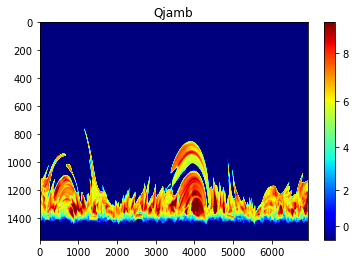

In [8]:
scan=37
heat = (1e-20+Qjamb[:,scan,:])*1e3
den = (1e-20+p[:,scan,:])*1e-7
amb_part = heat/den
plt.imshow(np.log10(np.abs(amb_part).T),cmap='jet',vmin=-1,vmax=9.2,norm=colors.PowerNorm(gamma=1.2),aspect='auto')
plt.colorbar()
plt.title('Qjamb')


  0%|          | 0/90 [00:00<?, ?it/s]/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:4: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  after removing the cwd from sys.path.
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:11: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later
  # This is added back by InteractiveShellApp.init_path()

 22%|██▏       | 20/90 [00:42<02:27,  2.11s/it]/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memo

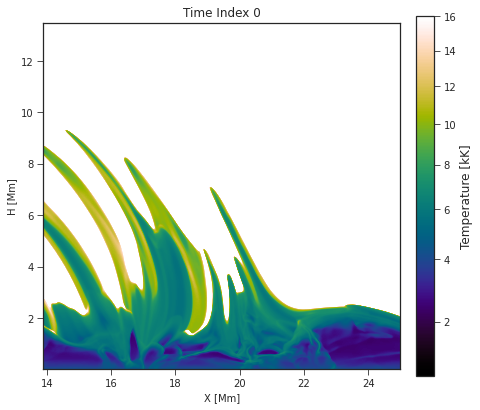

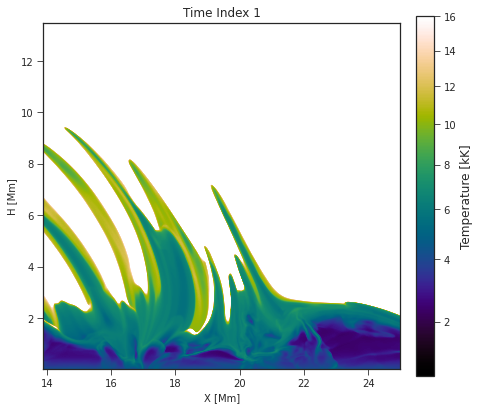

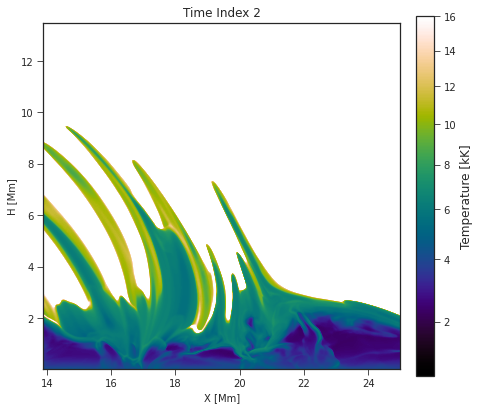

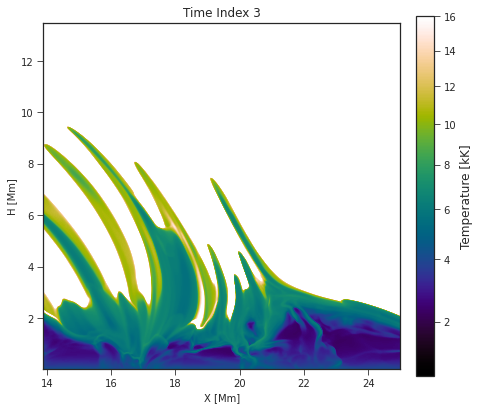

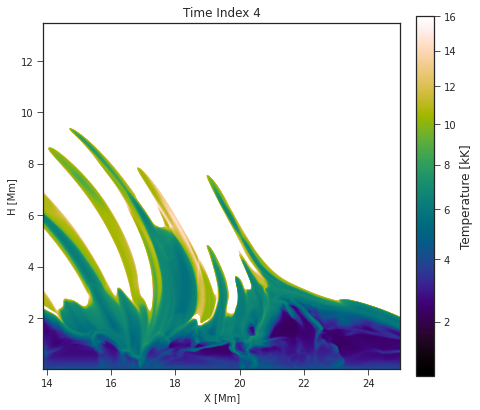

...

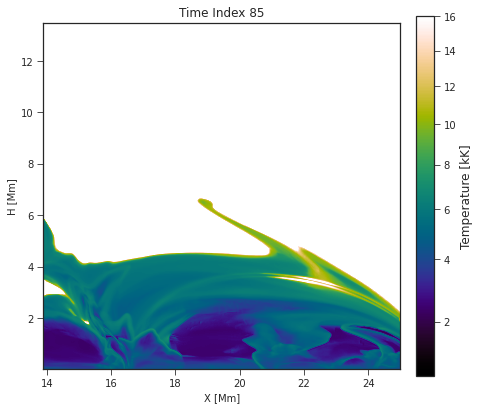

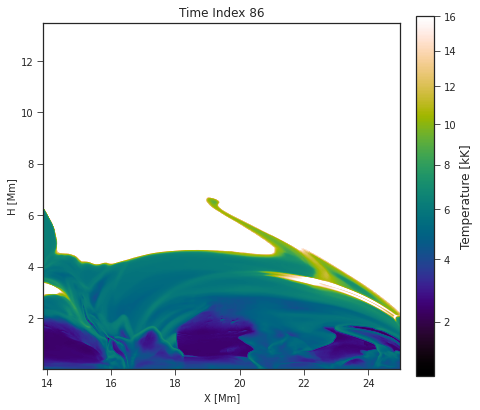

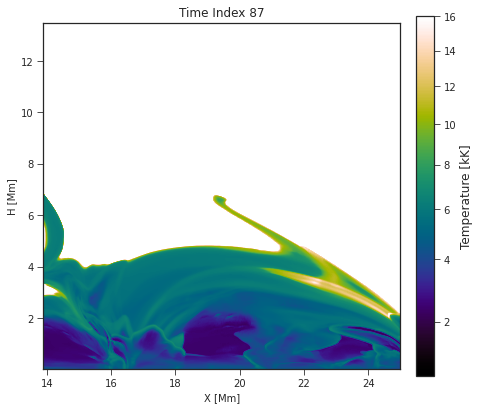

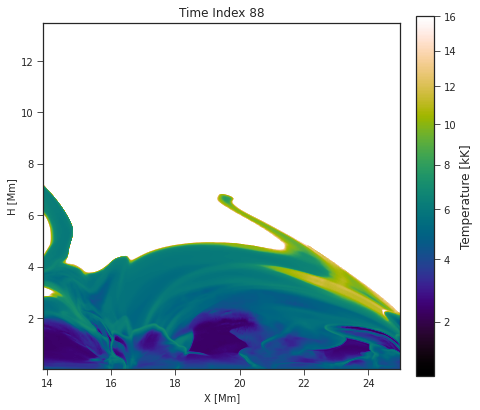

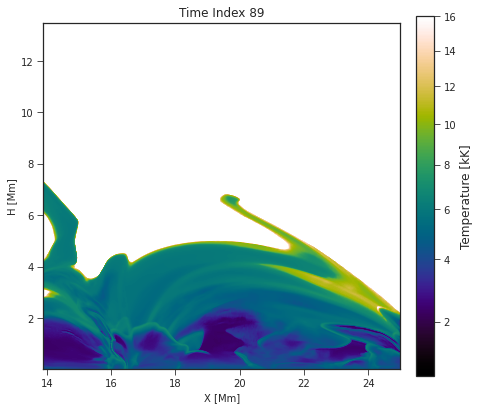

In [65]:
plt.style.use('seaborn-ticks')
for scan in tqdm(range(90)):
    plt.figure(figsize=(7,7))
    im1=plt.imshow((temp_juan[0,1000:1800,scan,500:1410].T)/1e3,cmap=cmr.rainforest,vmax=1.6e4/1e3,vmin=1,norm=colors.PowerNorm(gamma=0.7),aspect=0.8,extent=[x[1000]/1e6,x[1800]/1e6,z1[1410],z1[500]])
    cbar=plt.colorbar(im1,fraction=0.046, pad=0.04)
    cbar.set_label('Temperature [kK]',size=12)
    plt.xlabel('X [Mm]')
    plt.ylabel('H [Mm]')
    plt.title('Time Index '+str(scan))
    #plt.show()
    plt.savefig('/mn/stornext/d9/souvikb/High_impact/Juan_simulation/Temp-'+str(scan)+'.png',dpi=300,orientation='landscape',bbox_inches = 'tight',pad_innches=0.1)
    
    

### So you have to consider the time index from 7-67

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:23: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.


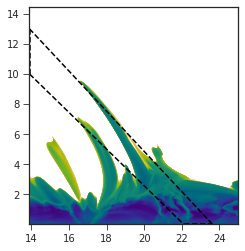

In [69]:
scan=25
# point1 = [22.13,0.006] #Checking the ROI
# point2 = [23.63,0.006]
# point3 = [13.9,13]
# point4 = [13.9,10.1]
point1 = [22.10,0.006] #Checking the ROI
point2 = [23.63,0.006]
point3 = [13.9,13.]
point4 = [13.9,10.]
x_values1 = [point1[0], point2[0]]
y_values1 = [point1[1], point2[1]]

x_values2 =[point2[0],point3[0]]
y_values2 = [point2[1],point3[1]]

x_values3 =[point3[0],point4[0]]
y_values3 = [point3[1],point4[1]]

x_values4 = [point4[0],point1[0]]
y_values4 = [point4[1],point1[1]]


plt.imshow((temp_juan[0,1000:1800,scan,470:1410].T)/1e3,cmap=cmr.rainforest,vmax=1.6e4/1e3,vmin=1,norm=colors.PowerNorm(gamma=0.7),aspect=0.8,extent=[x[1000]/1e6,x[1800]/1e6,z1[1410],z1[470]])
plt.plot(x_values1, y_values1,linestyle='--',color='black')
plt.plot(x_values2, y_values2,linestyle='--',color='black')
plt.plot(x_values3, y_values3,linestyle='--',color='black')
plt.plot(x_values4, y_values4,linestyle='--',color='black')

In [8]:
x[5]/1e3-x[4]/1e3

13.891770000000008

In [32]:
z[0,571]/1e6

11.50621

In [87]:
14000/13.9

1007.1942446043165

In [89]:
np.round(22000/13.9)

1583.0

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:19: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.


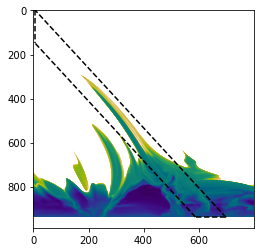

In [42]:
scan=30
point1 = [590.,940] #Checking the ROI
point2 = [700,940]
point3 = [7,0]
point4 = [7,150]
x_values1 = [point1[0], point2[0]]
y_values1 = [point1[1], point2[1]]

x_values2 =[point2[0],point3[0]]
y_values2 = [point2[1],point3[1]]

x_values3 =[point3[0],point4[0]]
y_values3 = [point3[1],point4[1]]

x_values4 = [point4[0],point1[0]]
y_values4 = [point4[1],point1[1]]


plt.imshow((temp_juan[0,1000:1800,scan,470:1410].T)/1e3,cmap=cmr.rainforest,vmax=1.6e4/1e3,vmin=1,norm=colors.PowerNorm(gamma=0.7),aspect=0.8)
plt.plot(x_values1, y_values1,linestyle='--',color='black')
plt.plot(x_values2, y_values2,linestyle='--',color='black')
plt.plot(x_values3, y_values3,linestyle='--',color='black')
plt.plot(x_values4, y_values4,linestyle='--',color='black')



In [37]:
np.round(22100/13.9)-1000,np.round(23630/13.9)-1000,np.round(14000/13.9)-1000,np.round(14000/13.9)-1000

(590.0, 700.0, 7.0, 7.0)

## Temperature ROI and space-time

In [43]:
x_slice =[1000,1800]
y_slice =[470,1410]
roi_spicule_temp = np.zeros((x_slice[1]-x_slice[0],y_slice[1]-y_slice[0],90))
for time in tqdm(range(90)):
    nx, ny = 940, 800
    poly_verts =[(940,593),(940,701), (0,0), (150,0)] #poly_verts =[(940,593),(940,701), (50,0), (168,0)]
    x, y = np.meshgrid(np.arange(nx), np.arange(ny))
    x, y = x.flatten(), y.flatten()
    points = np.vstack((x,y)).T
    path = Path(poly_verts)
    grid = path.contains_points(points)
    grid = np.array(grid.reshape((ny,nx)))
    mask_contour=np.zeros((800,940))
    temp_for_contour = temp_juan[0,1000:1800,time,470:1410]
    w_pixels = np.where(temp_for_contour<=100000)
    mask_contour[w_pixels]=1.
    roi_spicule_temp[:,:,time]=grid*temp_juan[0,1000:1800,time,470:1410]*mask_contour

100%|██████████| 90/90 [00:47<00:00,  1.91it/s]



  0%|          | 0/90 [00:00<?, ?it/s]/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:6: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:13: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later
  del sys.path[0]

 22%|██▏       | 20/90 [00:30<01:43,  1.49s/it]/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  "

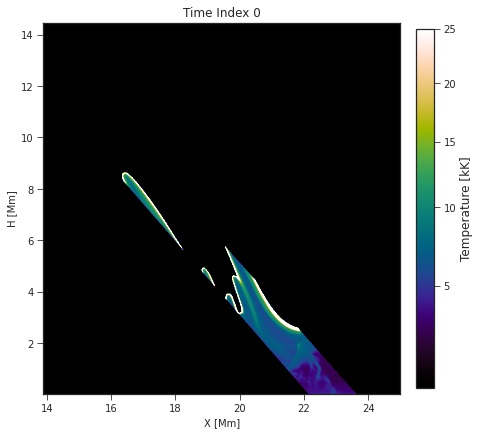

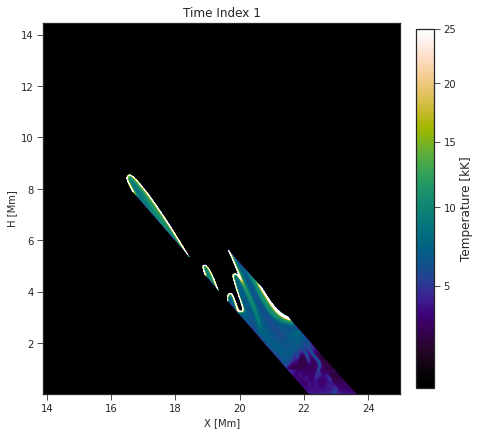

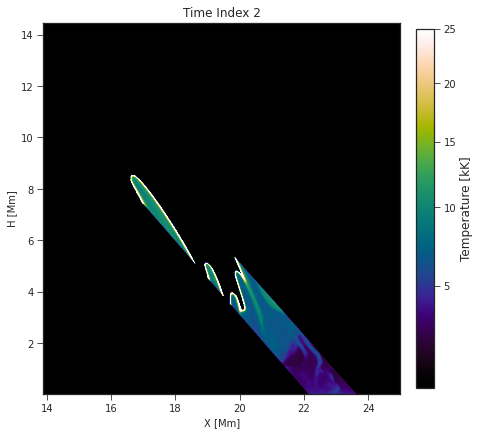

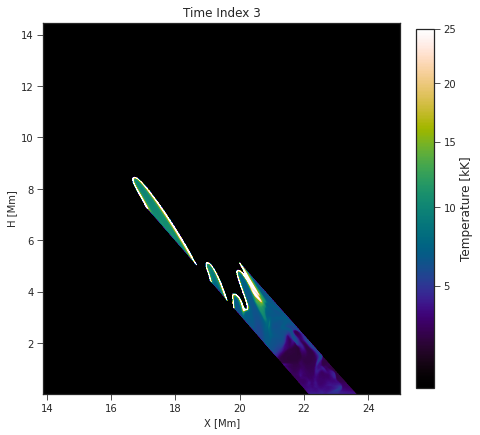

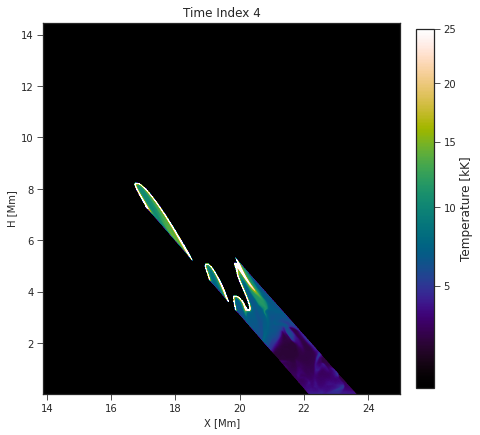

...

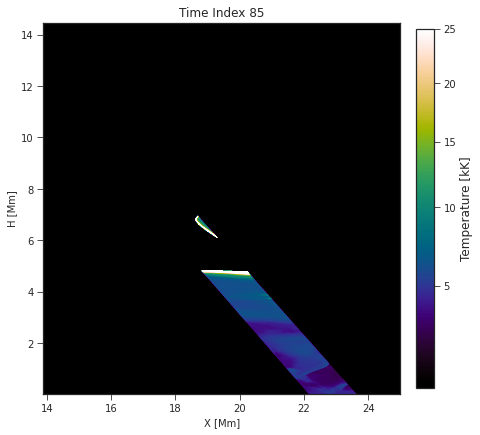

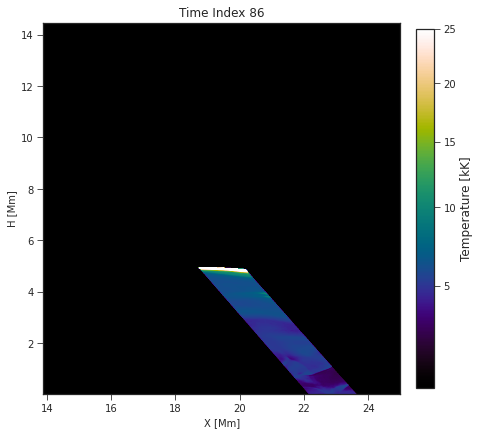

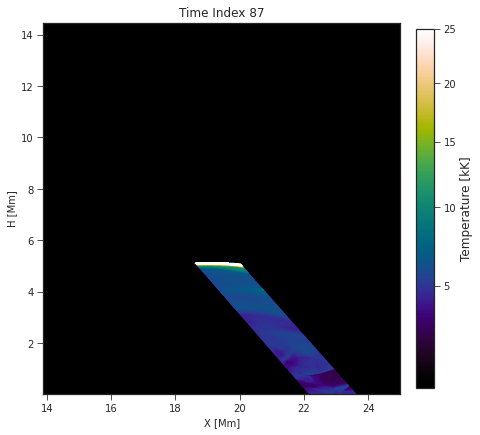

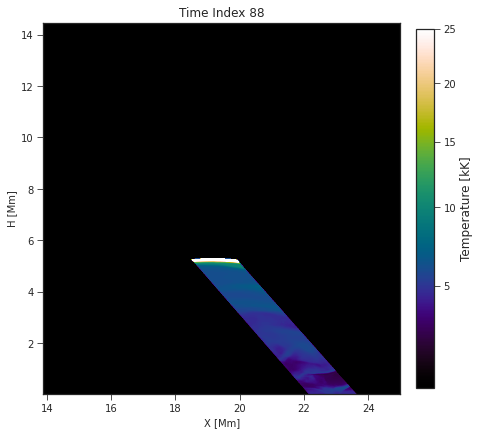

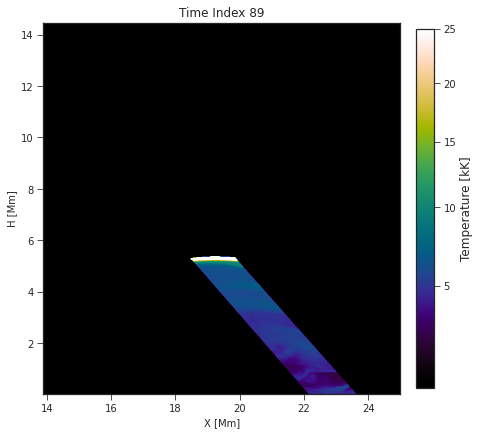

In [417]:
##-----Movie of the ROI just to be sure------

plt.style.use('seaborn-ticks')
for scan in tqdm(range(90)):
    plt.figure(figsize=(7,7))
    im1=plt.imshow((roi_spicule_temp[:,:,scan].T)/1e3,cmap=cmr.rainforest,vmax=2.5e4/1e3,vmin=1,norm=colors.PowerNorm(gamma=0.7),aspect=0.8,extent=[x[1000]/1e6,x[1800]/1e6,z1[1410],z1[470]])
    cbar=plt.colorbar(im1,fraction=0.046, pad=0.04)
    cbar.set_label('Temperature [kK]',size=12)
    plt.xlabel('X [Mm]')
    plt.ylabel('H [Mm]')
    plt.title('Time Index '+str(scan))
    #plt.show()
    plt.savefig('/mn/stornext/d9/souvikb/High_impact/Juan_simulation/ROI_Temp-'+str(scan)+'.png',dpi=300,orientation='landscape',bbox_inches = 'tight',pad_innches=0.1)



In [44]:
masked = np.ma.masked_equal(roi_spicule_temp, 0)

In [45]:
T_xt_slit = np.mean(masked,axis=0)

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:1: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  """Entry point for launching an IPython kernel.


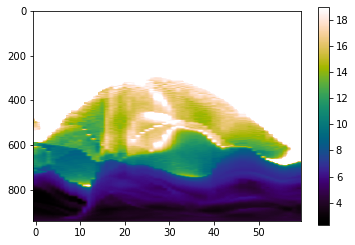

In [46]:
plt.imshow(T_xt_slit[:,7:67]/1e3,aspect=0.05,cmap=cmr.rainforest,norm=colors.PowerNorm(gamma=0.99),vmax=1.9e4/1e3)
plt.colorbar()

## Energy ROI and space-time

In [47]:
x_slice =[1000,1800]
y_slice =[470,1410]
roi_spicule = np.zeros((x_slice[1]-x_slice[0],y_slice[1]-y_slice[0],90))
for time in tqdm(range(90)):
    nx, ny = 940, 800
    poly_verts =[(940,593),(940,701), (0,0), (150,0)]
    x, y = np.meshgrid(np.arange(nx), np.arange(ny))
    x, y = x.flatten(), y.flatten()
    points = np.vstack((x,y)).T
    path = Path(poly_verts)
    grid = path.contains_points(points)
    grid = np.array(grid.reshape((ny,nx)))
    mask_contour=np.zeros((800,940))
    temp_for_contour = temp_juan[0,1000:1800,time,470:1410]
    w_pixels = np.where(temp_for_contour<=30000)
    mask_contour[w_pixels]=1.
    roi_spicule[:,:,time]=grid*e[1000:1800,time,470:1410]*mask_contour*1e5 #1e5 is to convert Bifrost units to CGS
    

100%|██████████| 90/90 [01:45<00:00,  1.17s/it]



  0%|          | 0/90 [00:00<?, ?it/s]/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: divide by zero encountered in log10
  """
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:5: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  """
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later
  if sys.path[0] == '':

 22%|██▏       | 20/90 [00:31<01:50,  1.58s/it]/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) a

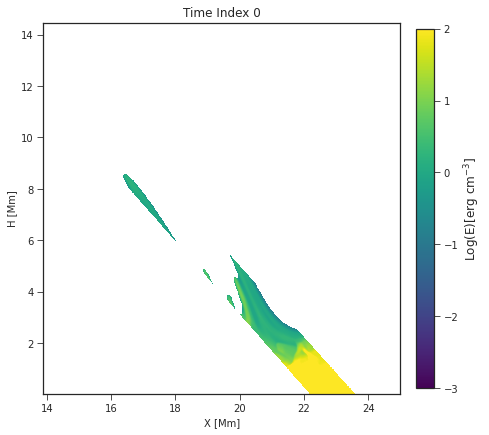

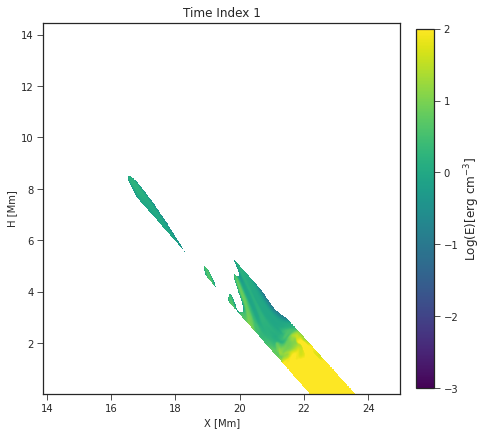

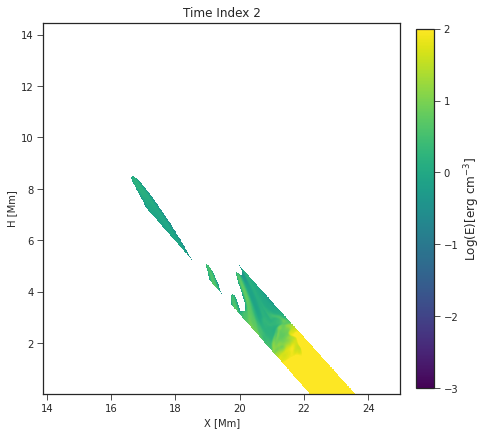

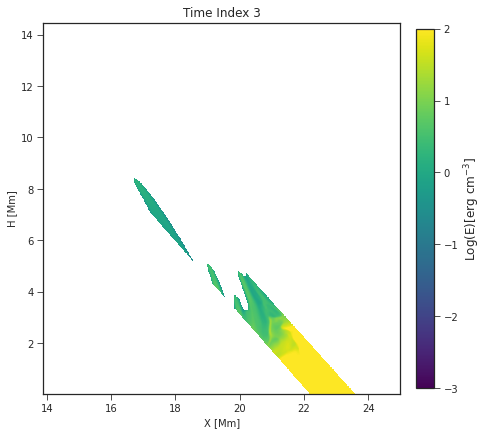

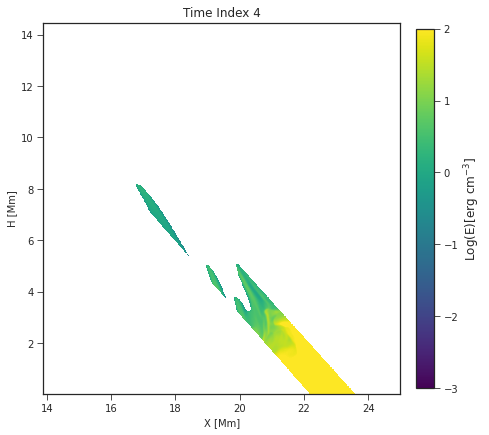

...

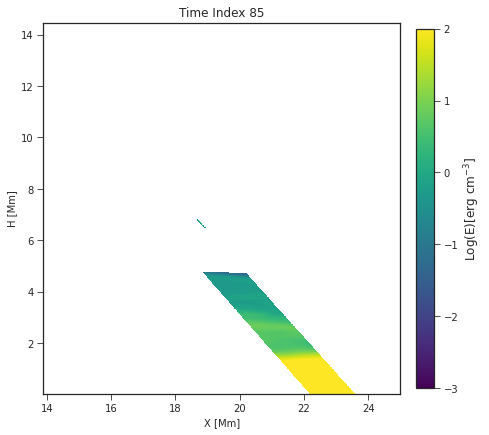

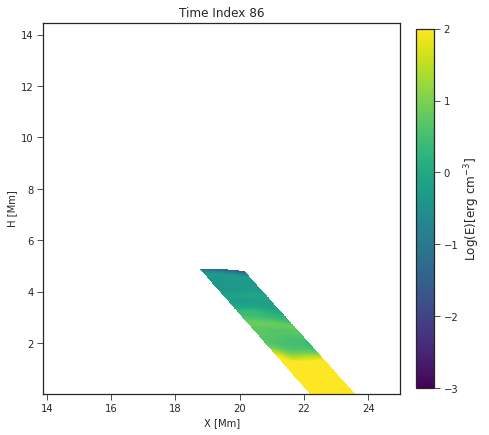

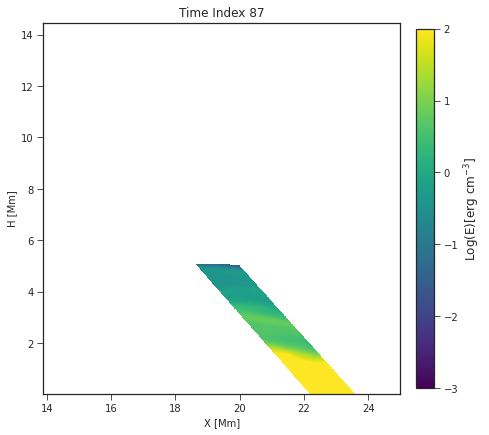

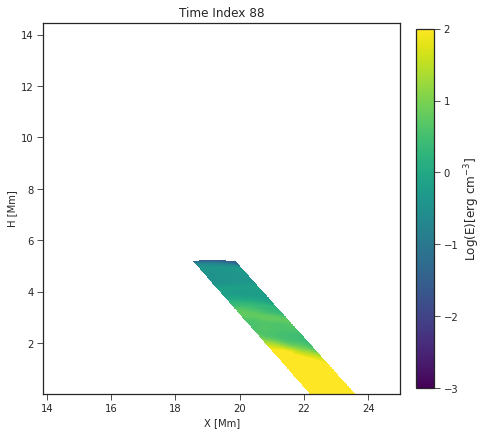

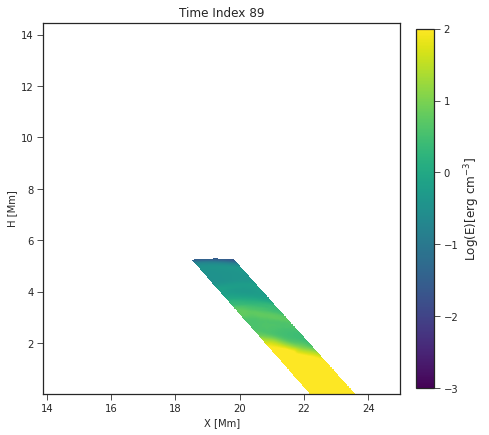

In [347]:
##---- Movie of the Energy ROI-----
plt.style.use('seaborn-ticks')
for scan in tqdm(range(90)):
    plt.figure(figsize=(7,7))
    im1=plt.imshow(np.log10(roi_spicule[:,:,scan].T),cmap='viridis',vmax=2,vmin=-3,norm=colors.PowerNorm(gamma=1),aspect=0.8,extent=[x[1000]/1e6,x[1800]/1e6,z1[1410],z1[470]])
    cbar=plt.colorbar(im1,fraction=0.046, pad=0.04)
    cbar.set_label(r'Log(E)[erg cm$^{-3}$]',size=12)
    plt.xlabel('X [Mm]')
    plt.ylabel('H [Mm]')
    plt.title('Time Index '+str(scan))
    #plt.show()
    plt.savefig('/mn/stornext/d9/souvikb/High_impact/Juan_simulation/ROI_Energy-'+str(scan)+'.png',dpi=300,orientation='landscape',bbox_inches = 'tight',pad_innches=0.1)



In [50]:
E_xt_slit = np.mean(roi_spicule,axis=0)

In [453]:
z1[470+168],z1[470+50]

(9.970819, 12.89406)

## Summed heat ROI and space-time

In [51]:
x_slice =[1000,1800]
y_slice =[470,1410]
roi_heat = np.zeros((x_slice[1]-x_slice[0],y_slice[1]-y_slice[0],90))
for time in (range(90)):
#     time+=35
    nx, ny = 940, 800
    poly_verts =[(940,593),(940,701), (0,0), (150,0)]
    x, y = np.meshgrid(np.arange(nx), np.arange(ny))
    x, y = x.flatten(), y.flatten()
    points = np.vstack((x,y)).T
    path = Path(poly_verts)
    grid = path.contains_points(points)
    grid = np.array(grid.reshape((ny,nx)))
    mask_contour=np.zeros((800,940))
    temp_for_contour = temp_juan[0,1000:1800,time,470:1410]
    w_pixels = np.where(temp_for_contour<=30000)
    mask_contour[w_pixels[0],w_pixels[1]]=1.
    Summed_Q = Qjoule[1000:1800,time,470:1410]+Qjamb[1000:1800,time,470:1410]+Qvisc[1000:1800,time,470:1410]+Qspitz[1000:1800,time,470:1410]
    Summed_Q = (1e-20+Summed_Q)*1e3 #1e-20 is for avoiding numerical zeros and 1e3 is to convert to CGS
    den = (1e-20+p[1000:1800,time,470:1410])*1e-7 # Same here. 
    heat_part = (Summed_Q/den)*mask_contour
    roi_heat[:,:,time] = grid*heat_part
#     plt.imshow(np.log10(np.abs(roi_heat[:,:,0]).T),cmap='jet')
    


  0%|          | 0/90 [00:00<?, ?it/s]/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: divide by zero encountered in log10
  """
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in log10
  """
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:5: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  """
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later
  if sys.path[0] == '':

 22%|██▏       | 20/90 [00:36<02:09,  1.85s/it]/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:4

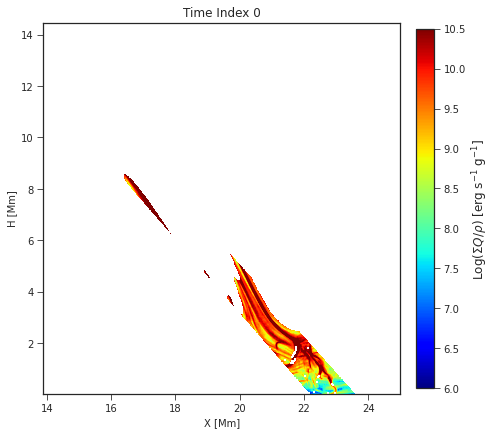

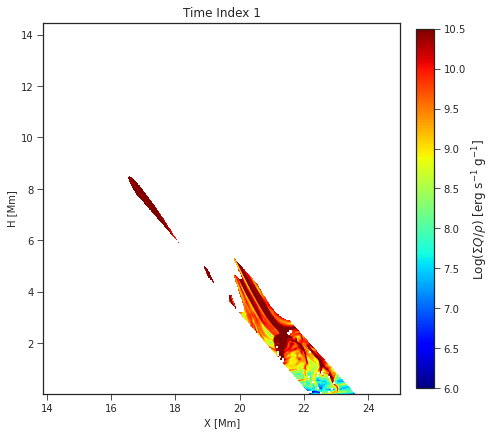

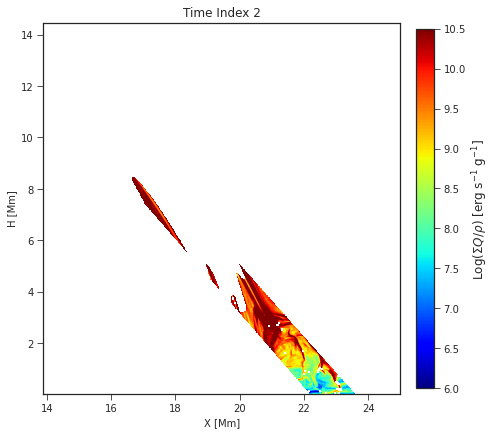

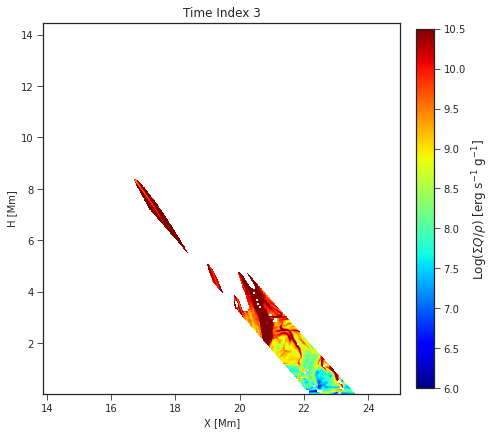

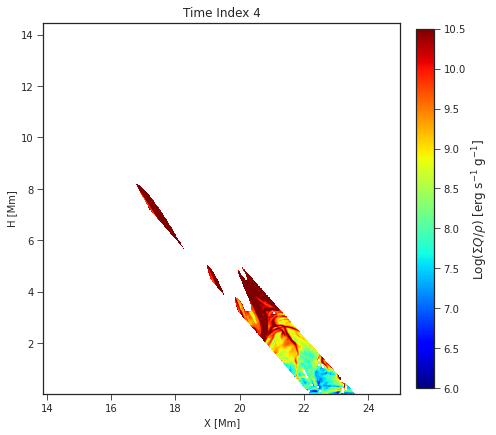

...

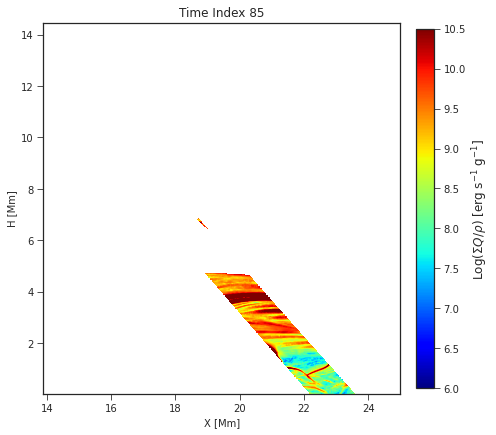

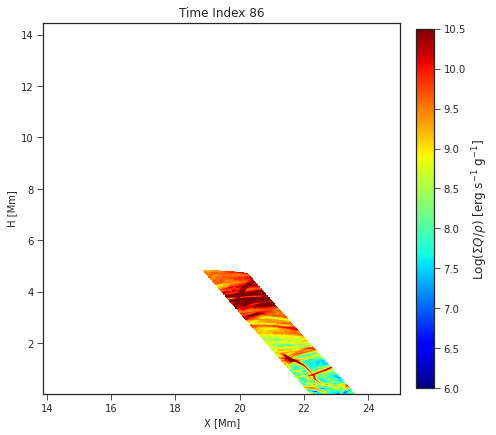

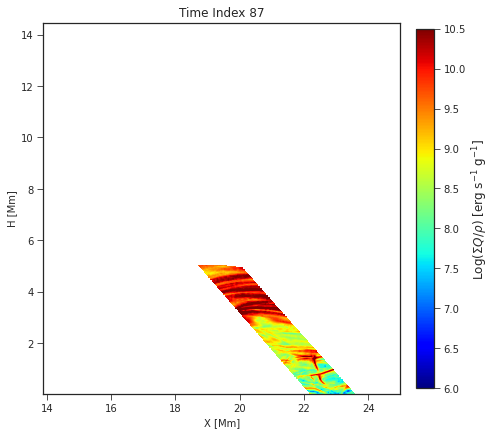

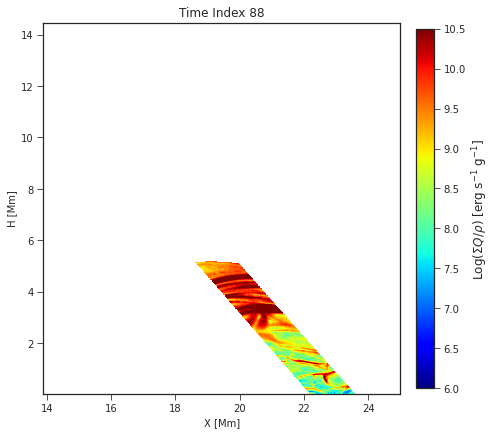

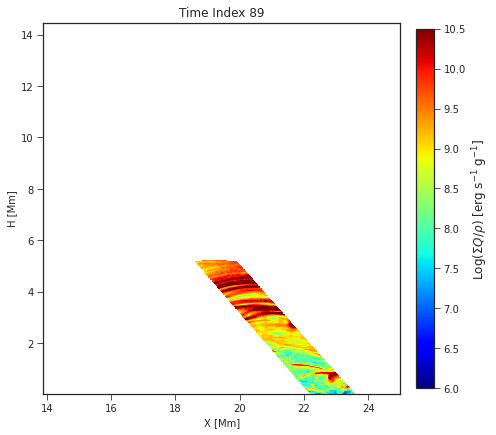

In [363]:
##---- Movie of the Heating terms ROI-----
plt.style.use('seaborn-ticks')
for scan in tqdm(range(90)):
    plt.figure(figsize=(7,7))
    im1=plt.imshow(np.log10(roi_heat[:,:,scan].T),cmap='jet',vmax=10.5,vmin=6,norm=colors.PowerNorm(gamma=1),aspect=0.8,extent=[x[1000]/1e6,x[1800]/1e6,z1[1410],z1[470]])
    cbar=plt.colorbar(im1,fraction=0.046, pad=0.04)
    cbar.set_label(r'Log($\Sigma$$Q$/$\rho$) [erg s$^{-1}$ g$^{-1}$]',size=12)
    plt.xlabel('X [Mm]')
    plt.ylabel('H [Mm]')
    plt.title('Time Index '+str(scan))
    #plt.show()
    plt.savefig('/mn/stornext/d9/souvikb/High_impact/Juan_simulation/ROI_Heat-'+str(scan)+'.png',dpi=300,orientation='landscape',bbox_inches = 'tight',pad_innches=0.1)




In [52]:
masked_heat = np.ma.masked_equal(roi_heat, 0)

In [53]:
heat_xt_slit = np.mean(masked_heat,axis=0)

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: divide by zero encountered in log10
  """Entry point for launching an IPython kernel.


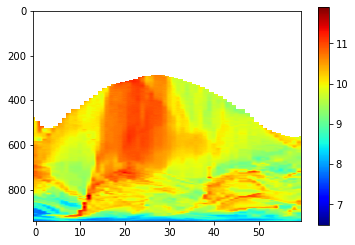

In [54]:
plt.imshow(np.log10(np.abs(heat_xt_slit[:,7:67])),cmap='jet',aspect=0.05,vmin=6.5,vmax=11.9)
plt.colorbar()

In [379]:
heat_xt_slit.shape

(940, 90)

In [322]:
heat_xt_slit.shape, E_xt_slit.shape, T_xt_slit.shape

((940, 90), (940, 90), (940, 90))

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: divide by zero encountered in log10
  """Entry point for launching an IPython kernel.


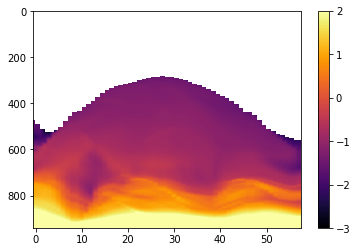

In [55]:
plt.imshow(np.log10(E_xt_slit[:,7:65]),aspect=0.05,cmap ='inferno',vmax=2,vmin=-3)
plt.colorbar()

  0%|          | 0/60 [00:00<?, ?it/s]/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:23: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:40: RuntimeWarning: divide by zero encountered in log10
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:51: RuntimeWarning: divide by zero encountered in log10
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:68: RuntimeWarning: divide by zero encountered in log10
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in log10
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:88: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_in

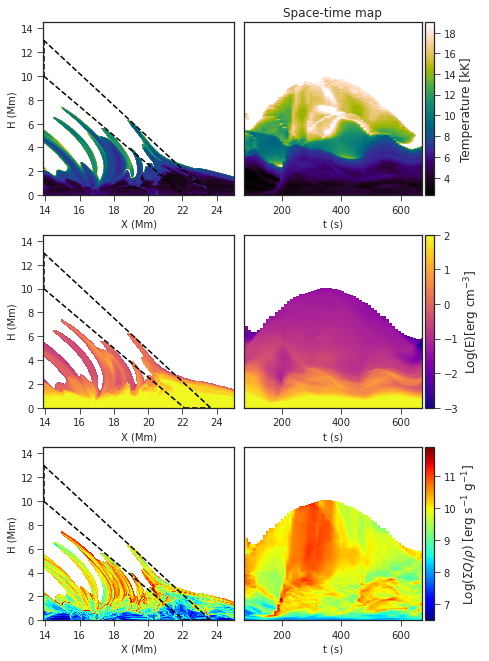

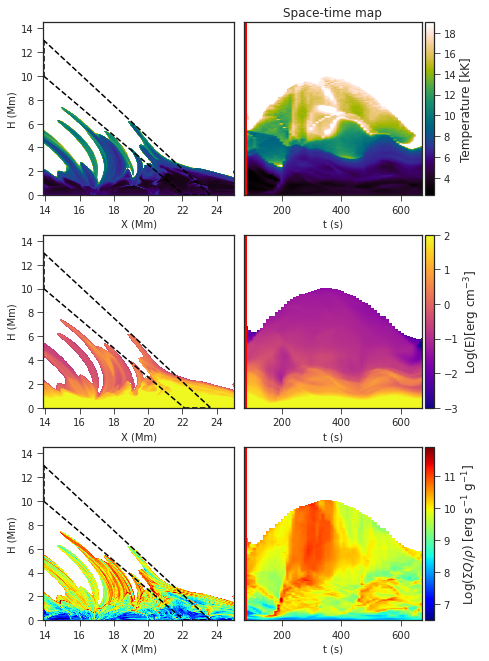

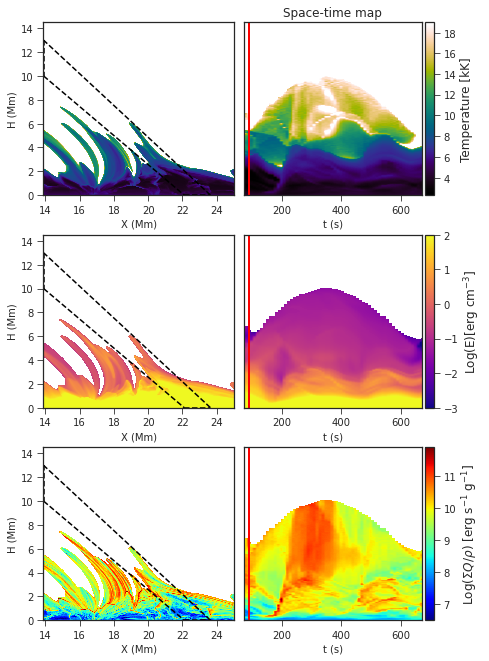

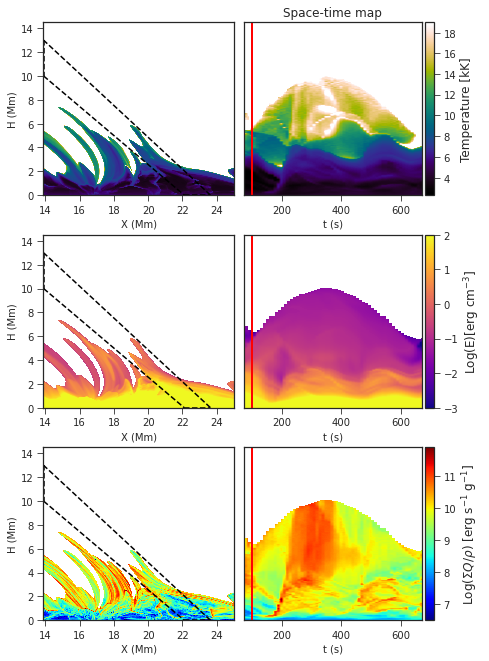

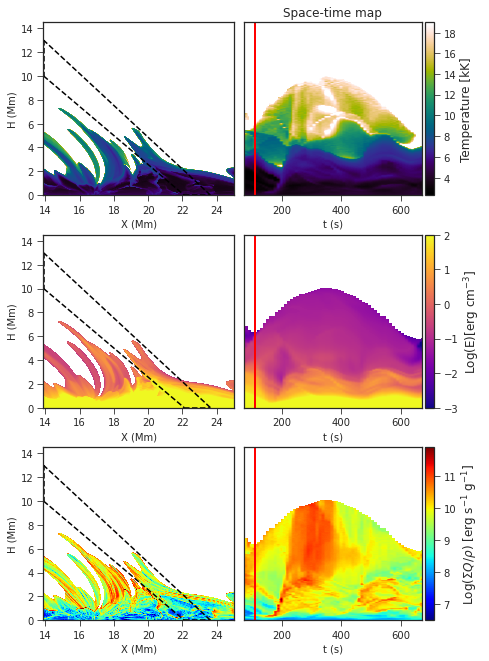

...

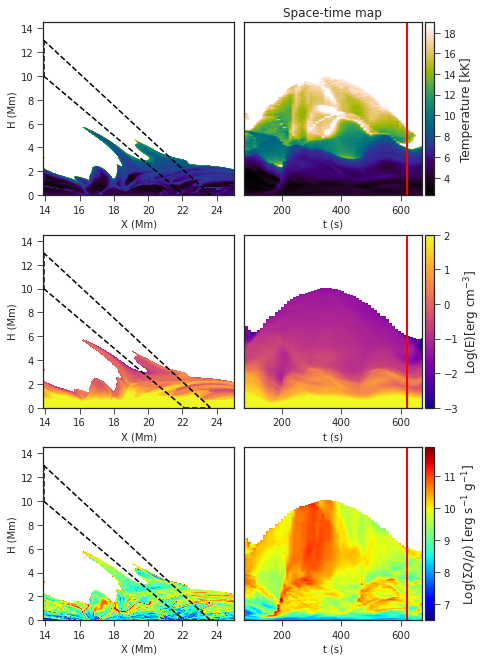

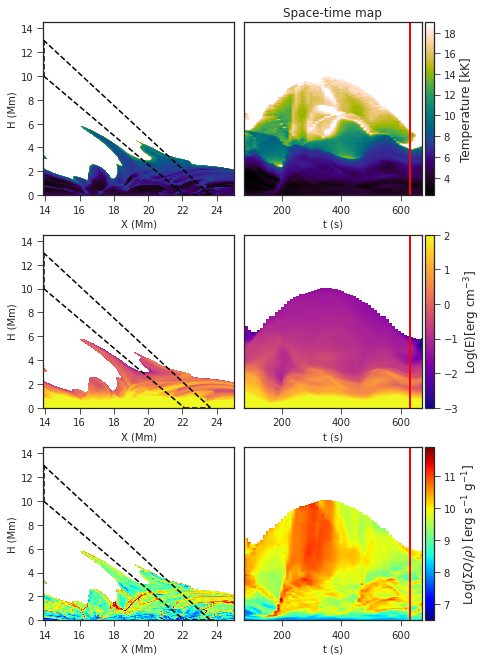

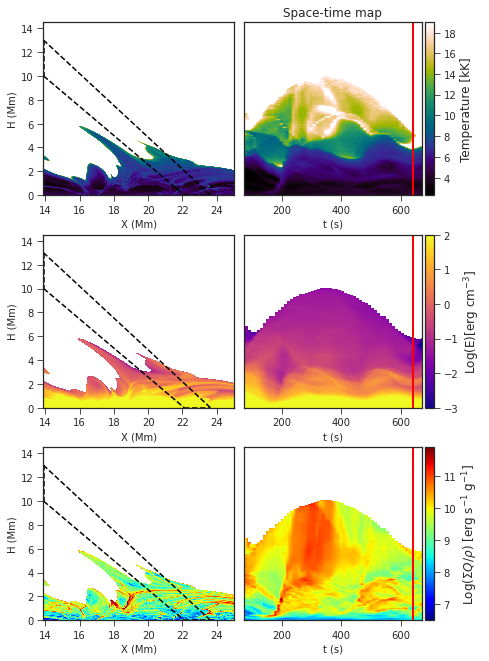

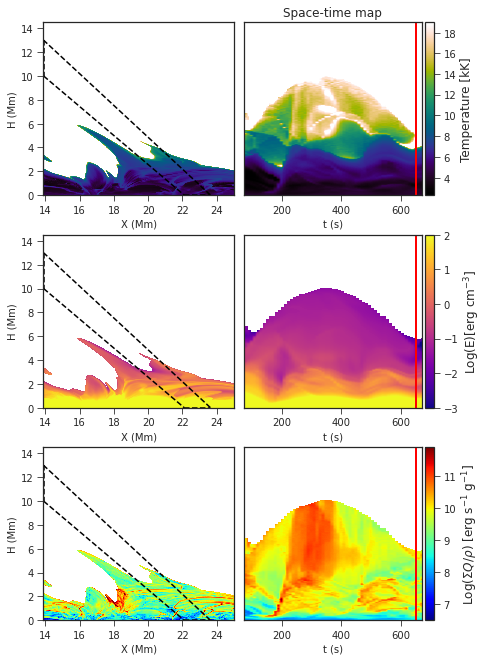

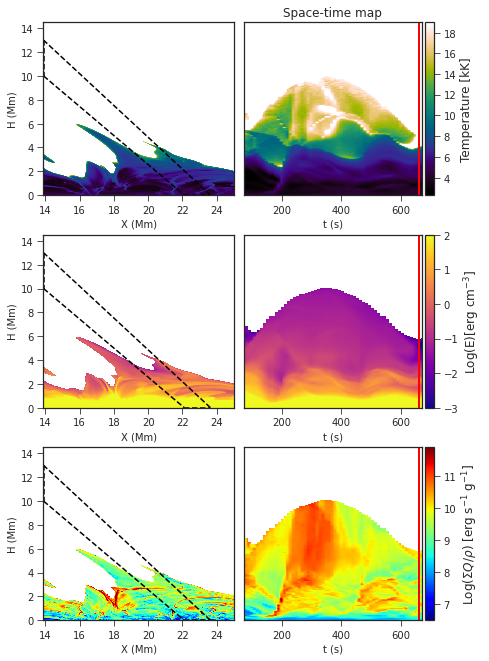

In [76]:
plt.style.use('seaborn-ticks')
for scan1 in tqdm(range(60)):
    fig, axs = plt.subplots(nrows=3, ncols=2, figsize=(7,11))
    fig.subplots_adjust(hspace = 0.23,wspace=0.05)
    axs=axs.ravel()
    scan = scan1+7
    norm1 = cm.colors.Normalize(vmax=1.9e4/1e3, vmin=1)
    im0 = NonUniformImage(axs[0], interpolation=None,cmap=cmr.rainforest,norm=norm1,extent=[x[1000]/1e6,x[1800]/1e6,z1[1410],z1[470]])
    im0.set_data(x[1000:1800]/1e6,z1[1410:470:-1],np.flipud(np.squeeze((temp_juan[0,1000:1800,scan,470:1410]/1e3).T)))
    axs[0].images.append(im0)
    axs[0].set_xlim(x[1000]/1e6, x[1800]/1e6)
    axs[0].set_ylim(0,14.5)
    axs[0].plot(x_values1, y_values1,linestyle='--',color='black')
    axs[0].plot(x_values2, y_values2,linestyle='--',color='black')
    axs[0].plot(x_values3, y_values3,linestyle='--',color='black')
    axs[0].plot(x_values4, y_values4,linestyle='--',color='black')
    axs[0].set_xlabel('X (Mm)')
    axs[0].set_ylabel('H (Mm)')
    # divider = make_axes_locatable(axs[0])
    # cax0 = divider.append_axes("right", size="5%", pad=0.05)
    # plt.colorbar(im0,cax=cax0)

    im1=axs[1].imshow((T_xt_slit[:,7:67]/1e3),aspect='auto',cmap=cmr.rainforest,vmax=1.9e4/1e3,norm=colors.PowerNorm(gamma=0.99),extent=[x2[7],x2[67],z1[1410],z1[470]])
    axs[1].set_yticks([])
    divider = make_axes_locatable(axs[1])
    cax0 = divider.append_axes("right", size="5%", pad=0.05)
    cbar=plt.colorbar(im1,cax=cax0)
    cbar.set_label('Temperature [kK]',size=12)
    axs[1].set_xlabel(r't (s)')
    axs[1].set_title('Space-time map')
    axs[1].axvline(x=x2[scan],color='red',linestyle='-',linewidth=2)

    mask_contour=np.zeros((800,940))
    temp_for_contour = temp_juan[0,1000:1800,scan,470:1410]
    w_pixels = np.where(temp_for_contour<=30000)
    mask_contour[w_pixels[0],w_pixels[1]]=1.

    norm2 = cm.colors.Normalize(vmax=2, vmin=-3)
    im2 = NonUniformImage(axs[2], interpolation=None, extent=[x[1000]/1e6,x[1800]/1e6,z1[1410],z1[470]],cmap='plasma',norm=norm2)
    im2.set_data(x[1000:1800]/1e6,z1[1410:470:-1],np.flipud(np.squeeze(np.log10((e[1000:1800,scan,470:1410]*mask_contour).T*1e5))))
    axs[2].images.append(im2)
    axs[2].set_xlim(x[1000]/1e6, x[1800]/1e6)
    axs[2].set_ylim(0,14.5)
    axs[2].plot(x_values1, y_values1,linestyle='--',color='black')
    axs[2].plot(x_values2, y_values2,linestyle='--',color='black')
    axs[2].plot(x_values3, y_values3,linestyle='--',color='black')
    axs[2].plot(x_values4, y_values4,linestyle='--',color='black')
    axs[2].set_xlabel('X (Mm)')
    axs[2].set_ylabel('H (Mm)')

    im3=axs[3].imshow(np.log10(E_xt_slit[:,7:67]),aspect='auto',cmap ='plasma',vmin=-3,vmax=2,extent=[x2[7],x2[67],z1[1410],z1[470]])
    axs[3].set_yticks([])
    divider = make_axes_locatable(axs[3])
    cax3 = divider.append_axes("right", size="5%", pad=0.05)
    cbar=plt.colorbar(im3,cax=cax3)
    cbar.set_label(r'Log(E)[erg cm$^{-3}$]',size=12)
    axs[3].set_xlabel(r't (s)')
    #axs[3].set_title('Space-time map')
    axs[3].axvline(x=x2[scan],color='red',linestyle='-',linewidth=2)

    Summed_Q = Qjoule[1000:1800,scan,470:1410]+Qjamb[1000:1800,scan,470:1410]+Qvisc[1000:1800,scan,470:1410]+Qspitz[1000:1800,scan,470:1410]
    Summed_Q = (1e-20+Summed_Q)*1e3
    den = (1e-20+p[1000:1800,scan,470:1410])*1e-7
    heat_part = (Summed_Q/den)*mask_contour
    
    norm2 = cm.colors.Normalize(vmax=11.9, vmin=6.5)
    im2 = NonUniformImage(axs[4], interpolation=None, extent=[x[1000]/1e6,x[1800]/1e6,z1[1410],z1[470]],cmap='jet',norm=norm2)
    im2.set_data(x[1000:1800]/1e6,z1[1410:470:-1],np.flipud(np.squeeze(np.log10(np.abs(heat_part.T)))))
    axs[4].images.append(im2)
    axs[4].set_xlim(x[1000]/1e6, x[1800]/1e6)
    axs[4].set_ylim(0,14.5)
    axs[4].plot(x_values1, y_values1,linestyle='--',color='black')
    axs[4].plot(x_values2, y_values2,linestyle='--',color='black')
    axs[4].plot(x_values3, y_values3,linestyle='--',color='black')
    axs[4].plot(x_values4, y_values4,linestyle='--',color='black')
    axs[4].set_xlabel('X (Mm)')
    axs[4].set_ylabel('H (Mm)')

    im3=axs[5].imshow(np.log10(heat_xt_slit[:,7:67]),aspect='auto',cmap ='jet',vmin=6.5,vmax=11.9,extent=[x2[7],x2[67],z1[1410],z1[470]])
    axs[5].set_yticks([])
    divider = make_axes_locatable(axs[5])
    cax3 = divider.append_axes("right", size="5%", pad=0.05)
    cbar=plt.colorbar(im3,cax=cax3)
    cbar.set_label(r'Log($\Sigma$$Q$/$\rho$) [erg s$^{-1}$ g$^{-1}$]',size=12)
    axs[5].set_xlabel(r't (s)')
    #axs[3].set_title('Space-time map')
    axs[5].axvline(x=x2[scan],color='red',linestyle='-',linewidth=2)
    plt.savefig('/mn/stornext/d9/souvikb/High_impact/Juan_simulation/Energy_density2-'+str(scan1)+'.png',dpi=300,orientation='landscape',bbox_inches = 'tight',pad_innches=0.1)

In [454]:
x_values1

[22.0, 23.5]

In [456]:
#poly_verts =[(940,593),(940,701), (50,0), (168,0)]
z1[470+50],z1[470+168],z1[470+940]

(12.89406, 9.970819, 0.006103516)

In [459]:
x[1593]/1e6,x[1000+701]/1e6

(22.1296, 23.62991)

In [ ]:
point1 = [22.13,0.006] #Checking the ROI
point2 = [23.63,0.006]
point3 = [13.9,12.89]
point4 = [13.9,10]

In [460]:
x[1000]/1e6

13.89177